## import library 

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix , classification_report

In [2]:
data=pd.read_csv('data.csv')
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


## data wrangling

In [3]:
data.shape

(569, 33)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [5]:
data.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


In [6]:
data.diagnosis.value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

## Exploratory data analysis

/home/sumit/anaconda3/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


<AxesSubplot:xlabel='diagnosis', ylabel='count'>

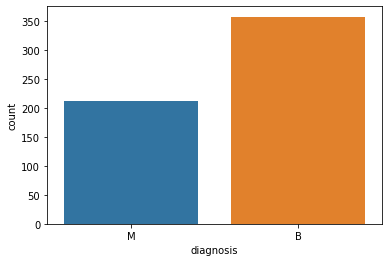

In [7]:
sns.countplot(data['diagnosis'])

/home/sumit/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0, 0.5, 'Probebility density')

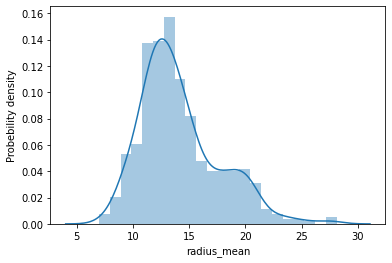

In [8]:
sns.distplot(data['radius_mean'])
plt.ylabel('Probebility density')

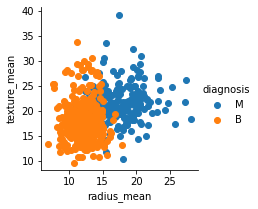

In [9]:
sns.FacetGrid(data, hue='diagnosis').map(plt.scatter, 'radius_mean','texture_mean').add_legend()

## identify the highly correlated feature

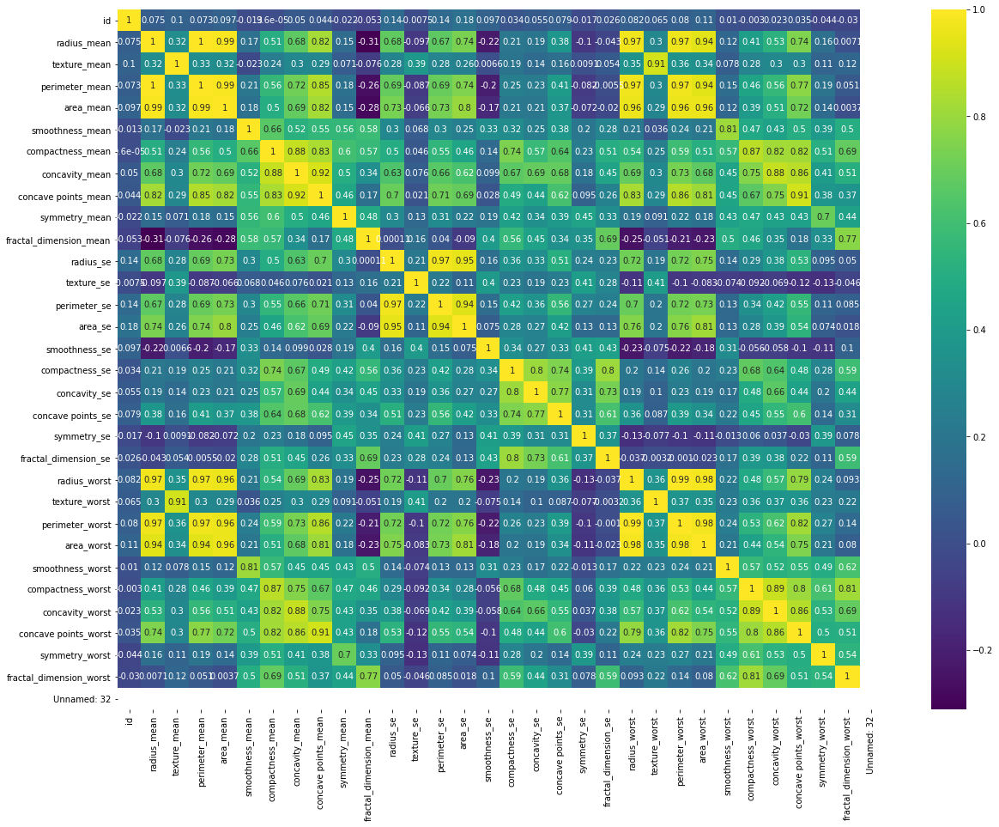

In [10]:
### there is a lot of overlapping in the disgnosis
plt.figure(figsize=(20,15))
sns.heatmap(data.corr(),cmap='viridis', annot=True)
plt.show()

In [11]:
corr_matrix=data.corr().abs()
upper=corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
## find correlation which are greater than the 0.95 
to_drop=[column for column in upper.columns if any(upper[column]>0.95)]

In [12]:
data[to_drop]

,perimeter_mean,area_mean,perimeter_se,area_se,radius_worst,perimeter_worst,area_worst
0,122.80,1001.0,8.589,153.40,25.380,184.60,2019.0
1,132.90,1326.0,3.398,74.08,24.990,158.80,1956.0
2,130.00,1203.0,4.585,94.03,23.570,152.50,1709.0
3,77.58,386.1,3.445,27.23,14.910,98.87,567.7
4,135.10,1297.0,5.438,94.44,22.540,152.20,1575.0
...,...,...,...,...,...,...,...
564,142.00,1479.0,7.673,158.70,25.450,166.10,2027.0
565,131.20,1261.0,5.203,99.04,23.690,155.00,1731.0
566,108.30,858.1,3.425,48.55,18.980,126.70,1124.0
567,140.10,1265.0,5.772,86.22,25.740,184.60,1821.0


/home/sumit/anaconda3/lib/python3.8/site-packages/seaborn/distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:xlabel='area_mean', ylabel='Density'>

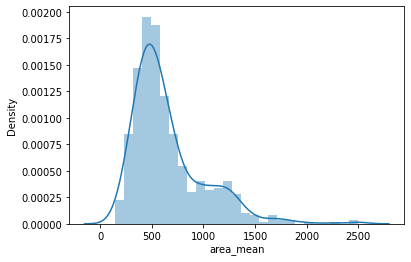

In [13]:
sns.distplot(data['area_mean'])

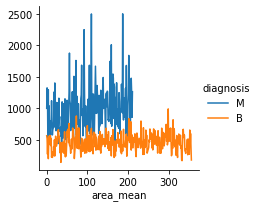

In [14]:
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'area_mean').add_legend()

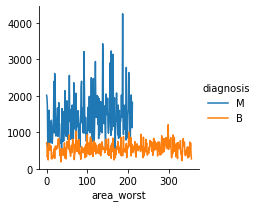

In [15]:
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'area_worst').add_legend()

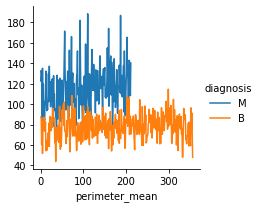

In [16]:
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'perimeter_mean').add_legend()

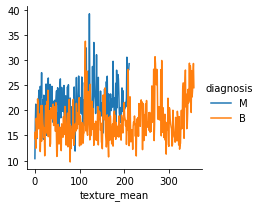

In [17]:
# texture_mean
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'texture_mean').add_legend()

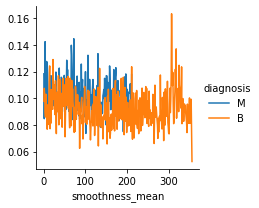

In [18]:
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'smoothness_mean').add_legend()

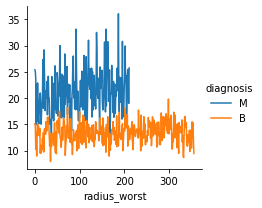

In [19]:
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'radius_worst').add_legend()

In [20]:
## drop the highlg correlated feature which is independently to each other
data.drop(to_drop, axis=1, inplace=True)

In [21]:
data.shape

(569, 26)

In [22]:
sns.pairplot(data, hue='diagnosis', size=5)

/home/sumit/anaconda3/lib/python3.8/site-packages/seaborn/axisgrid.py:1912: UserWarning: The `size` parameter has been renamed to `height`; please update your code.
  warnings.warn(msg, UserWarning)


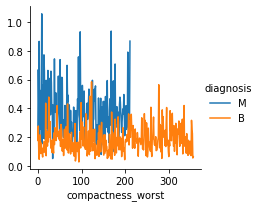

In [23]:
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'compactness_worst').add_legend()

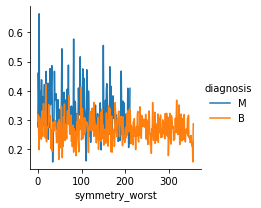

In [24]:
sns.FacetGrid(data, hue='diagnosis').map(plt.plot, 'symmetry_worst').add_legend()

In [25]:
## now data is clear .

In [26]:
data.drop('id',axis=1, inplace=True)

In [27]:
data.head()

,diagnosis,radius_mean,texture_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,...,symmetry_se,fractal_dimension_se,texture_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,M,17.99,10.38,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,...,0.03003,0.006193,17.33,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,M,20.57,17.77,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,...,0.01389,0.003532,23.41,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,M,19.69,21.25,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,...,0.02250,0.004571,25.53,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,M,11.42,20.38,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,...,0.05963,0.009208,26.50,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,M,20.29,14.34,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,...,0.01756,0.005115,16.67,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [28]:
data['Unnamed: 32'].isnull().sum()

569

In [29]:
data.drop('Unnamed: 32' ,axis=1, inplace=True)

In [30]:
x=data.drop('diagnosis', axis=1)
y=data['diagnosis']

In [31]:
x.head()

,radius_mean,texture_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,radius_se,texture_se,...,concave points_se,symmetry_se,fractal_dimension_se,texture_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,17.99,10.38,0.11840,0.27760,0.3001,0.14710,0.2419,0.07871,1.0950,0.9053,...,0.01587,0.03003,0.006193,17.33,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,20.57,17.77,0.08474,0.07864,0.0869,0.07017,0.1812,0.05667,0.5435,0.7339,...,0.01340,0.01389,0.003532,23.41,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,19.69,21.25,0.10960,0.15990,0.1974,0.12790,0.2069,0.05999,0.7456,0.7869,...,0.02058,0.02250,0.004571,25.53,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,11.42,20.38,0.14250,0.28390,0.2414,0.10520,0.2597,0.09744,0.4956,1.1560,...,0.01867,0.05963,0.009208,26.50,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,20.29,14.34,0.10030,0.13280,0.1980,0.10430,0.1809,0.05883,0.7572,0.7813,...,0.01885,0.01756,0.005115,16.67,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [32]:
y.head()

0    M
1    M
2    M
3    M
4    M
Name: diagnosis, dtype: object

In [36]:
from sklearn.model_selection import train_test_split
x_train ,x_test , y_train ,y_test=train_test_split(x, y, test_size=0.3, random_state=0)
logistic=LogisticRegression(max_iter=1000)
logistic.fit(x_train_scaler , y_train)
print("training set score :",logistic.score(x_train_scaler ,y_train))
print('testing set score :', logistic.score(x_test_scaler , y_test))

print('\n')
predict1=logistic.predict(x_test_scaler)
print(confusion_matrix(y_test, predict1))
print(classification_report(y_test , predict1))

training set score : 0.9874371859296482
testing set score : 0.9590643274853801


[[105   3]
 [  4  59]]
              precision    recall  f1-score   support

           B       0.96      0.97      0.97       108
           M       0.95      0.94      0.94        63

    accuracy                           0.96       171
   macro avg       0.96      0.95      0.96       171
weighted avg       0.96      0.96      0.96       171



In [46]:
for C, marker in zip([0.001, 1, 100], ['o', '^', 'v']):
    lr_l1 = LogisticRegression(C=C).fit(x_train_scaler, y_train)
    print("Training accuracy of l1 logreg with C={:.3f}: {:.2f}".format(C, lr_l1.score(x_train_scaler, y_train)))
    print("Test accuracy of l1 logreg with C={:.3f}: {:.2f}".format(C, lr_l1.score(x_test_scaler, y_test)))


Training accuracy of l1 logreg with C=0.001: 0.86
Test accuracy of l1 logreg with C=0.001: 0.86
Training accuracy of l1 logreg with C=1.000: 0.99
Test accuracy of l1 logreg with C=1.000: 0.96
Training accuracy of l1 logreg with C=100.000: 0.99
Test accuracy of l1 logreg with C=100.000: 0.92


/home/sumit/anaconda3/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:762: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [35]:
## Apply the machine learning model
from sklearn.model_selection import train_test_split
x_train ,x_test , y_train ,y_test=train_test_split(x, y, test_size=0.3, random_state=0)
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x_train_scaler=scaler.fit_transform(x_train)
x_test_scaler=scaler.fit_transform(x_test)

In [37]:
from sklearn.model_selection import train_test_split
x_train ,x_test , y_train ,y_test=train_test_split(x, y, test_size=0.3, random_state=0)
logistic=LogisticRegression(max_iter=1000)
logistic.fit(x_train_scaler , y_train)
print("training set score :",logistic.score(x_train_scaler ,y_train))
print('testing set score :', logistic.score(x_test_scaler , y_test))

print('\n')
predict1=logistic.predict(x_test_scaler)
print(confusion_matrix(y_test, predict1))
print(classification_report(y_test , predict1))

training set score : 0.9874371859296482
testing set score : 0.9590643274853801


[[105   3]
 [  4  59]]
              precision    recall  f1-score   support

           B       0.96      0.97      0.97       108
           M       0.95      0.94      0.94        63

    accuracy                           0.96       171
   macro avg       0.96      0.95      0.96       171
weighted avg       0.96      0.96      0.96       171



In [38]:
neighbor=KNeighborsClassifier(n_neighbors=3)
neighbor.fit(x_train_scaler ,y_train)
print(neighbor.score(x_train_scaler,y_train))
print(neighbor.score(x_test_scaler , y_test))
print('\n')

predict2=neighbor.predict(x_test_scaler)
print(confusion_matrix(y_test, predict2))
print(classification_report(y_test , predict2))

0.9773869346733668
0.935672514619883


[[104   4]
 [  7  56]]
              precision    recall  f1-score   support

           B       0.94      0.96      0.95       108
           M       0.93      0.89      0.91        63

    accuracy                           0.94       171
   macro avg       0.94      0.93      0.93       171
weighted avg       0.94      0.94      0.94       171



In [39]:
decision=DecisionTreeClassifier(max_depth=3)
decision.fit(x_train_scaler ,y_train)
print(decision.score(x_train_scaler ,y_train))
print(decision.score(x_test_scaler, y_test))
predict12=decision.predict(x_test_scaler)
print(confusion_matrix(y_test, predict12))
print(classification_report(y_test , predict12))

0.9597989949748744
0.9415204678362573
[[101   7]
 [  3  60]]
              precision    recall  f1-score   support

           B       0.97      0.94      0.95       108
           M       0.90      0.95      0.92        63

    accuracy                           0.94       171
   macro avg       0.93      0.94      0.94       171
weighted avg       0.94      0.94      0.94       171



In [40]:
random=RandomForestClassifier(max_depth=3)
random.fit(x_train_scaler ,y_train)
print(random.score(x_train_scaler,y_train))
print(random.score(x_test_scaler, y_test))
predict3=random.predict(x_test_scaler)
print(confusion_matrix(y_test, predict3))

print(classification_report(y_test , predict3))

0.9723618090452262
0.9239766081871345
[[102   6]
 [  7  56]]
              precision    recall  f1-score   support

           B       0.94      0.94      0.94       108
           M       0.90      0.89      0.90        63

    accuracy                           0.92       171
   macro avg       0.92      0.92      0.92       171
weighted avg       0.92      0.92      0.92       171



In [52]:
from sklearn.svm import SVC
svm=SVC()
svm.fit(x_train_scaler, y_train)
print(svm.score(x_train_scaler, y_train))
print(svm.score(x_test_scaler, y_test))
print('\n')
predict4=svm.predict(x_test_scaler)
print(confusion_matrix(y_test , predict4))
print(classification_report(y_test , predict4))

0.9849246231155779
0.9707602339181286


[[107   1]
 [  4  59]]
              precision    recall  f1-score   support

           B       0.96      0.99      0.98       108
           M       0.98      0.94      0.96        63

    accuracy                           0.97       171
   macro avg       0.97      0.96      0.97       171
weighted avg       0.97      0.97      0.97       171

